In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import re

#Worldcloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

#Potly to dash dashboard
import plotly.express as px

In [3]:
%matplotlib inline

**Business context**

Electric networks failures in Urabá, region of Antioquia department in Colombia.

**Import data**

In [4]:
%%time
df = pd.read_excel('Original_Data/Reporte Uraba2019_CAGMV1Est.xlsx')

Wall time: 1min 25s


In [5]:
df.shape

(49494, 35)

In [6]:
pd.set_option('display.max_columns', None)
display(df.dtypes)

CallID                         object
NumberOT                        int64
TaskNumber                      int64
Status                         object
ServiceType                    object
id                             object
Eng_Type                       object
RepairDate             datetime64[ns]
FinalRepairDate        datetime64[ns]
DuratioMin                      int64
TaskType                       object
CompletionDate         datetime64[ns]
OpenDate               datetime64[ns]
EarlyStart             datetime64[ns]
DueDate                datetime64[ns]
DispatchDate           datetime64[ns]
TravelDate             datetime64[ns]
OnSiteDate             datetime64[ns]
Region                         object
District                       object
TreeServiceGroup               object
ServiceGroup                   object
BusinessLine                   object
town                           object
Latitude                        int64
Longitude                       int64
Priority    

In [7]:
###getting the number of rows with repeated 
display(df.CallID.value_counts().value_counts())
len(df.CallID.unique())

1      18390
2       4488
3       1592
4       1017
5        541
6        408
7        184
8        112
9         73
10        67
12        29
15        28
13        22
11        20
14        11
20        10
21         9
17         9
16         9
24         8
18         8
22         7
30         6
23         6
25         5
40         5
19         5
42         5
26         4
35         4
47         3
31         2
41         2
27         2
28         2
33         2
29         2
116        1
39         1
50         1
45         1
55         1
Name: CallID, dtype: int64

27102

In [8]:
df.head()

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
0,M_EPM_EN_3974557,3294596,1,Realizada,Daños Energía,E_D0239,CU-TyD-Moto_MttoDaños_X1,2019-12-31 19:24:00,2019-12-31 19:30:00,30,TRABAJOFUSIBLE,2019-12-31 19:53:55,2019-12-31 19:16:00,2019-12-31 19:16:00,2019-12-31 20:00:00,2019-12-31 19:17:00,2019-12-31 19:17:00,2019-12-31 19:24:06,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Carepa,7771097,-76809294,1,NaN,Se realizo reposición de fusible en el fr 4159...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1527996425,1460157,FR4159,Aisladero,405-13
1,M_EPM_EN_3974642,3294347,1,Realizada,Daños Energía,E_D0264,CU-TyD-Moto_MttoDaños_X1,2019-12-31 17:59:00,2019-12-31 18:23:00,30,INSPECQOS,2019-12-31 18:42:16,2019-12-31 10:23:53,2019-12-31 10:23:00,2019-12-31 18:23:00,2019-12-31 11:07:00,2019-12-31 17:46:12,2019-12-31 17:52:35,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Turbo,8108337,-76732551,4,NaN,Se llega a el cirio y se encuentra que el daño...,REVISIÓN POR CALIDAD DEL SERVICIO,1527808009,1459416,402-11,Salida Circuito,402-11
2,M_EPM_EN_3974707,3294568,2,Realizada,Daños Energía,E_D0223,CU-TyD-Moto_MttoDaños_X1,2019-12-31 17:57:00,2019-12-31 17:59:00,30,INSPECQOS,2019-12-31 18:16:57,2019-12-31 17:46:00,2019-12-31 17:46:00,2020-01-03 17:37:00,2019-12-31 17:48:00,2019-12-31 17:54:36,2019-12-31 17:55:35,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Necoclí,8466042,-76598210,4,NaN,Se realizó inspección encontrándose poste a pu...,CAMBIAR/ASEGURAR POSTE PRIMARIO - Ramales,1527955467,1460101,489023,Transformador,415-12
3,MX_EPM_0133_DE_2037523,2037523,1,Realizada,Mto. Ener. Actividades Forestales,E_MP219,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 18:10:00,2019-12-10 08:40:00,2019-12-27 07:00:00,2019-12-27 17:00:00,2019-12-30 14:55:00,2019-12-31 07:11:00,2019-12-31 07:18:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Necoclí,8420147,-76646490,7,NaN,corregimiento pueblo nuevo \nvereda comarca ...,NaN,1517256747,1419179,R1269,CIRCUITO 415-12 SEGMENTO R1269,NaN
4,M_EPM_EN_3974852,3294520,1,Realizada,Daños Energía,E_D0270,CU-TyD-Moto_MttoDaños_X1,2019-12-31 16:52:00,2019-12-31 17:07:00,30,TRABAJOFUSIBLE,2019-12-31 18:02:33,2019-12-31 15:38:00,2019-12-31 15:38:00,2019-12-31 23:36:00,2019-12-31 15:40:00,2019-12-31 15:47:37,2019-12-31 16:48:53,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,San pedro de urabá,8418435,-76304074,1,NaN,Se repuso 1 fusible de 6T al F47910 el servici...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1527922700,1460058,478088,Transformador,407-12


¿Qué es cada observación?

No hay llave primaria

Varias filas hacen referencia a una misma intervención, pero en la cual se hicieron varios trabajos, uno por fila.

In [9]:
df.duplicated().value_counts()

False    49494
dtype: int64

**Missingness plot**

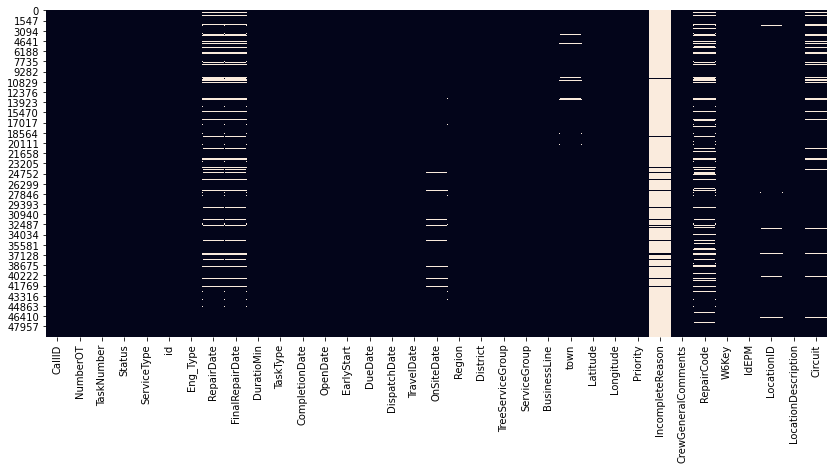

In [10]:
plt.figure(figsize=(14,6))
sns.heatmap(df.isnull(), cbar=False)

**Brief summary of categorical variables**

In [11]:
print('--- Service type ---')
display(df.ServiceType.value_counts())
print('Not null values:',df.ServiceType.isnull().value_counts()[0])

print('\n --- Status ---')
display(df.Status.value_counts())
print('Not null values:',df.Status.isnull().value_counts()[0])

print('\n --- Eng. type ---')
display(df.Eng_Type.value_counts())
print('Not null values:',df.Eng_Type.isnull().value_counts()[0])

print('\n --- Region (Of Antioquia department) ---')
display(df.Region.value_counts())
print('Not null values:',df.Region.isnull().value_counts()[0])

print('\n --- Town (Of Antioquia department) ---')
display(df.town.value_counts())
print('Not null values:',df.town.isnull().value_counts()[0])

print('\n --- Priority ---')
display(df.Priority.value_counts())
print('Not null values:',df.Priority.isnull().value_counts()[0])

print('\n --- TaskNumber ---')
display(df.TaskNumber.value_counts())
print('Not null values:',df.TaskNumber.isnull().value_counts()[0])

print('\n --- LocationDescription ---')
display(df.LocationDescription.value_counts())
print('Not null values:',df.LocationDescription.isnull().value_counts()[0])



--- Service type ---


Daños Energía                        33224
Mantenimiento Energía                14321
Mto. Ener. Actividades Forestales     1695
Mantenimiento Línea Viva               240
Mantenimiento Subterránea               14
Name: ServiceType, dtype: int64

Not null values: 49494

 --- Status ---


Realizada       46545
No Realizada     2949
Name: Status, dtype: int64

Not null values: 49494

 --- Eng. type ---


CU-TyD-Moto_MttoDaños_X1                 36549
CU-TyD-Camioneta_Mtto_X3                  3795
CU-TyD-Camioneta_Mtto_X4                  2581
CU-TyD-Moto_Poda_X2                       2409
CU-TyD-Camioneta_Poda_X4                  1380
CU-TyD-Camion_Mtto_X4                     1348
CU-TyD-Camioneta_MttoDaños Prepago_x2      524
CU-TyD-Moto_MttoDaños Prepago_X1           266
CU-TyD-Canasta Tipo II                     262
CU-TyD-Camioneta_Mtto_EquiEsp_Calidad      190
CU-TyD-Moto_Calidad_Geo                    169
CU-TyD-Camioneta_SubterraneaX3               9
CU-TyD-Canasta Tipo I                        8
CU-TyD-Camioneta_SubterraneaX4               2
CU-TyD-Moto_MttoDaños_X2                     2
Name: Eng_Type, dtype: int64

Not null values: 49494

 --- Region (Of Antioquia department) ---


Uraba    49494
Name: Region, dtype: int64

Not null values: 49494

 --- Town (Of Antioquia department) ---


Turbo                        10911
Necoclí                       6914
Apartadó                      6271
Carepa                        4556
San pedro de urabá            4459
Chigorodó                     4018
Arboletes                     2748
San juan de urabá             2356
Mutatá                        1927
Currulao                      1535
Nueva Colonia                 1334
Belen de Bajira                858
La Atoyosa                     658
Medellín                        24
San Pedro De Los Milagros       19
Nechí                           17
Riosucio                         9
Anzá                             6
San José De La Montaña           5
Caucasia                         5
Olaya                            3
Nariño                           2
Anorí                            2
El Carmen De Viboral             2
Murindó                          2
Segovia                          2
La estrella                      2
Carolina                         2
Caramanta           

Not null values: 48656

 --- Priority ---


9    12395
1    11889
4    10843
3     6214
2     5958
7     2116
5       79
Name: Priority, dtype: int64

Not null values: 49494

 --- TaskNumber ---


1      31161
2       9166
3       3032
4       1093
5        570
       ...  
205        1
141        1
132        1
124        1
300        1
Name: TaskNumber, Length: 166, dtype: int64

Not null values: 49494

 --- LocationDescription ---


Transformador                      34751
Salida Circuito                     6331
Aisladero                           2522
Reconectador                         696
Salida_Circuito                      636
                                   ...  
CIRCUITO 406-11 SEGMENTO FR4567        1
CIRCUITO 401-13 TRAMO C4481            1
CIRCUITO 407-13 NODO 478193            1
CIRCUITO 409-12 TRAMO FR471            1
CIRCUITO 404-12 TRAMO C4467            1
Name: LocationDescription, Length: 887, dtype: int64

Not null values: 49494


In [12]:
print('--- TaskType ---')
display(df.TaskType.value_counts())

print('--- Reason of no actions---')
display(df.IncompleteReason.value_counts())

print('--- Repair Code ---')
display(df.RepairCode.value_counts())

print('--- Crew General comments ---')
#display(df.CrewGeneralComments.unique())
#This have different case


--- TaskType ---


TRABAJOFUSIBLE           13090
EVENTOPROGRAM            12414
ATEMEDATC                 7957
TRABACOMSECUN             3743
INSPECQOS                 3066
INSPECSEGURIDAD           3023
PODARED01                 1299
TRABPUENTECONEX           1152
OPEMNBNOPROG               558
INSPRECORRIDORA            497
MTTOELEMREDAEREA           471
PODARED                    409
PODARED02PLANES            394
MTTORECONEAEREA            341
REPOFUSRA                  146
INSRETPTRA                 114
REALMTOEQUISECCLV           95
TRABAJOPOSTE                80
MTTOPTRA                    72
TRABSECCIOLV                55
INSRETPOSTERA               45
MTTOCUCHILLARA              45
ATEMEDATCPRE                40
INSRETELEAEREA              40
TRABAJOLINPRIMLV            38
INSRETCABRAPRIM             33
INSANTESCALINFRAELE         32
RETIROBJRED                 26
OPERMNBPROG                 24
TRASVESPOSTELV              23
AISLADA                     17
VERESTOPERRED               15
TRABAJOV

--- Reason of no actions---


TyD_594_Fuerza Mayor                                      898
TyD_626_Cancelado por el despacho                         598
TyD_624_Servicio Normal                                   347
TyD_622_Por recursos                                      340
TyD_406_Problemas de orden público                        147
TyD_595_Requiere otro tipo de cuadrilla                   137
TyD_607_Pedido duplicado para el mismo producto           122
TyD_623_Informacion errada o incompleta                   107
TyD_619_Actividad para otras dependencias                  88
TyD_596_Sin acceso a la instalación                        74
TyD_600_El cliente o solicitante pide anular solicitud     34
TyD_598_Vía cerrada                                        17
TyD_625_Falta Material                                     12
TyD_612_Localizado en área con restricción ambiental       10
TyD_597_Usuario no permitió realizar la labor              10
TyD_601_Requiere cambio de producto                         5
TyD_618_

--- Repair Code ---


ASEGURAR/REPARAR ACOMETIDAS DOMICILIARIAS                          5230
REVISIÓN POR CALIDAD DEL SERVICIO                                  4106
CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - Ramales               3765
CAMBIAR FUSIBLE A TRANSFORMADOR - Transformador                    3078
CAMBIAR/INSTALAR CONECTOR EN LA RED SECUNDARIA                     2115
                                                                   ... 
ALEJAR LINEA PRIMARIA AEREA AISLADA                                   1
REPONER LINEA PRIMARIA AEREA AISLADA - Alimentador principal          1
REPARAR TERMINAL EN CABLE PRIMARIO AISLADO - Salida de Circuito       1
CAMBIAR O INSTALAR PARARRAYO PRIMARIO - Salida de Circuito            1
REPARAR ACOMETIDA PRIMARIA CANALIZADA - Red Subterranea               1
Name: RepairCode, Length: 117, dtype: int64

--- Crew General comments ---


##### Status consistence

In [13]:
print(df.Status.value_counts())
print(df.IncompleteReason.isnull().sum())
print(df.RepairCode.isnull().sum())

Realizada       46545
No Realizada     2949
Name: Status, dtype: int64
46539
8909


In [14]:
display(pd.crosstab(df.Status,~df.IncompleteReason.isnull()))
display(pd.crosstab(df.Status,~df.RepairCode.isnull()))

IncompleteReason,False,True
Status,,
No Realizada,5,2944
Realizada,46534,11


RepairCode,False,True
Status,,
No Realizada,2728,221
Realizada,6181,40364


In [15]:
#Status "No Realizada" pero sin Incomplete Reason
df[(df.Status=='No Realizada') & (df.IncompleteReason.isnull()==True)]

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
16392,M_EPM_EN_3840683,3184324,2,No Realizada,Daños Energía,E_D0272,CU-TyD-Moto_MttoDaños_X1,2019-09-05 19:55:00,NaT,30,TRABAJOFUSIBLE,2019-09-05 16:10:00,2019-09-05 12:02:00,2019-09-05 15:00:00,2019-09-05 18:00:00,2019-09-05 16:08:00,2019-09-05 16:09:00,NaT,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Turbo,8091575,-76728368,2,NaN,"Este evento lo atendió la cuadrilla de ROR, au...",REVISIÓN POR CALIDAD DEL SERVICIO,1467990054,1169953,400224,Transformador,402-16
39402,M_EPM_EN_3649022,3027633,2,No Realizada,Mantenimiento Energía,E_MO211,CU-TyD-Camioneta_Mtto_X4,2019-04-02 09:52:00,2019-04-02 15:08:00,240,EVENTOPROGRAM,2019-04-02 20:09:00,2019-04-01 15:23:00,2019-04-01 15:23:00,2019-04-08 15:23:00,2019-04-01 17:04:00,2019-04-02 07:02:00,2019-04-02 08:26:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Turbo,8083515,-76705996,9,NaN,Se le dio cumplimiento ala STP205450 se repuso...,REPARAR Y/O REPONER DESCARGA A TIERRA-Ramales,1387757768,764588,C4111,Aisladero,411-13
39403,M_EPM_EN_3649022,3027633,2,No Realizada,Mantenimiento Energía,E_MO211,CU-TyD-Camioneta_Mtto_X4,2019-04-02 09:52:00,2019-04-02 15:08:00,240,EVENTOPROGRAM,2019-04-02 20:09:00,2019-04-01 15:23:00,2019-04-01 15:23:00,2019-04-08 15:23:00,2019-04-01 17:04:00,2019-04-02 07:02:00,2019-04-02 08:26:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Turbo,8083515,-76705996,9,NaN,Se le dio cumplimiento ala STP205450 se repuso...,CAMBIAR AISLADORES (COPA-PLATO) - Ramales,1387757768,764588,C4111,Aisladero,411-13
39404,M_EPM_EN_3649022,3027633,2,No Realizada,Mantenimiento Energía,E_MO211,CU-TyD-Camioneta_Mtto_X4,2019-04-02 09:52:00,2019-04-02 15:08:00,240,EVENTOPROGRAM,2019-04-02 20:09:00,2019-04-01 15:23:00,2019-04-01 15:23:00,2019-04-08 15:23:00,2019-04-01 17:04:00,2019-04-02 07:02:00,2019-04-02 08:26:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Turbo,8083515,-76705996,9,NaN,Se le dio cumplimiento ala STP205450 se repuso...,REPONER NEUTRO PRIMARIO - Ramales,1387757768,764588,C4111,Aisladero,411-13
39523,M_EPM_EN_3652922,3028347,2,No Realizada,Mantenimiento Energía,E_MO284,CU-TyD-Camioneta_Mtto_X3,2019-04-02 08:05:00,2019-04-02 13:34:00,240,EVENTOPROGRAM,2019-04-02 12:39:00,2019-04-02 07:42:54,2019-04-02 07:42:00,2019-04-09 07:41:00,2019-04-02 07:44:00,2019-04-02 08:04:00,2019-04-02 08:05:00,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Chigorodó,7667163,-76680770,9,NaN,Se e cancela este evento para activar otro de ...,REPARAR NEUTRO PRIMARIO - Ramales,1388093506,775547,473111,Transformador,403-12


In [16]:
#Status "Realizada" pero con Incomplete Reason
df[(df.Status=='Realizada') & (df.IncompleteReason.isnull()==False)]

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
10944,MX_EPM_0133_DE_1803448,1803448,1,Realizada,Mantenimiento Energía,E_D0238,CU-TyD-Moto_MttoDaños_X1,NaT,NaT,15,MTTOCUCHILLARA,2019-10-16 08:06:53,2019-10-13 12:41:00,2019-10-15 15:45:00,2019-10-15 16:00:00,2019-10-16 03:03:00,2019-10-16 08:01:45,2019-10-16 08:05:49,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Arboletes,8686745,-76422584,7,TyD_626_Cancelado por el despacho,Esta OT ya se realizo donde se realiza inspecc...,NaN,1488027655,1254715,407-41,CIRCUITO 407-41 TRAMO 407-41,NaN
15010,M_EPM_EN_3852029,3192889,1,Realizada,Daños Energía,E_D0222,CU-TyD-Moto_MttoDaños_X1,2019-09-13 11:32:00,2019-09-13 15:10:00,30,INSPECSEGURIDAD,2019-09-13 16:50:33,2019-09-13 10:05:00,2019-09-13 10:05:00,2019-09-14 10:05:00,2019-09-13 10:06:00,2019-09-13 10:15:30,2019-09-13 11:16:48,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Apartadó,7896965,-76584325,1,TyD_626_Cancelado por el despacho,Se reparó linea secundaria rota por caída de a...,PODAR ARBOLES - Ramales,1472233479,1183196,439121,Transformador,401-11
15011,M_EPM_EN_3852029,3192889,1,Realizada,Daños Energía,E_D0222,CU-TyD-Moto_MttoDaños_X1,2019-09-13 11:32:00,2019-09-13 15:10:00,30,INSPECSEGURIDAD,2019-09-13 16:50:33,2019-09-13 10:05:00,2019-09-13 10:05:00,2019-09-14 10:05:00,2019-09-13 10:06:00,2019-09-13 10:15:30,2019-09-13 11:16:48,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Apartadó,7896965,-76584325,1,TyD_626_Cancelado por el despacho,Se reparó linea secundaria rota por caída de a...,REPARAR LINEA SECUNDARIA ROTA,1472233479,1183196,439121,Transformador,401-11
15012,M_EPM_EN_3852029,3192889,1,Realizada,Daños Energía,E_D0222,CU-TyD-Moto_MttoDaños_X1,2019-09-13 11:32:00,2019-09-13 15:10:00,30,INSPECSEGURIDAD,2019-09-13 16:50:33,2019-09-13 10:05:00,2019-09-13 10:05:00,2019-09-14 10:05:00,2019-09-13 10:06:00,2019-09-13 10:15:30,2019-09-13 11:16:48,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Apartadó,7896965,-76584325,1,TyD_626_Cancelado por el despacho,Se reparó linea secundaria rota por caída de a...,CAMBIAR/INSTALAR CONECTOR EN LA RED SECUNDARIA,1472233479,1183196,439121,Transformador,401-11
15606,M_EPM_EN_3847481,3189458,1,Realizada,Daños Energía,E_D0216,CU-TyD-Moto_MttoDaños_X1,2019-09-10 15:00:00,2019-09-10 15:09:00,30,TRABAJOFUSIBLE,2019-09-10 15:09:45,2019-09-10 11:26:26,2019-09-10 11:26:00,2019-09-10 17:06:00,2019-09-10 14:17:00,2019-09-10 14:57:12,2019-09-10 15:02:05,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Mutatá,7368675,-76723219,1,TyD_623_Informacion errada o incompleta,Era. Unvreque. Disparado,NaN,1470619653,1179327,905631,Transformador,404-12
20001,M_EPM_EN_3810150,3159541,1,Realizada,Daños Energía,E_D0227,CU-TyD-Moto_MttoDaños_X1,2019-08-12 11:12:00,2019-08-12 12:54:00,30,INSPECQOS,2019-08-12 13:02:44,2019-08-12 06:43:22,2019-08-12 06:43:00,2019-08-15 06:42:00,2019-08-12 06:49:00,2019-08-12 10:22:16,2019-08-12 10:57:57,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Apartadó,7885123,-76624705,4,TyD_595_Requiere otro tipo de cuadrilla,Se reparan acometidas fatigadas en caja caja b...,ASEGURAR/REPARAR ACOMETIDAS DOMICILIARIAS,1455636504,1107281,426229,Transformador,401-12
22821,M_EPM_EN_3787762,3142285,2,Realizada,Daños Energía,E_D0273,CU-TyD-Moto_MttoDaños_X1,2019-07-24 14:50:00,2019-07-24 14:52:00,45,ATEMEDATC,2019-07-24 15:18:00,2019-07-24 12:54:00,2019-07-24 12:54:00,2019-07-26 12:53:00,2019-07-24 12:55:00,2019-07-24 12:56:00,2019-07-24 14:53:00,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD

In [17]:
#Status "No Realizada" pero con código de reparación
df[(df.Status=='No Realizada') & (df.RepairCode.isnull()==False)]

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
45,M_EPM_EN_3974464,3294169,1,No Realizada,Daños Energía,E_D0220,CU-TyD-Moto_MttoDaños_X1,2019-12-31 15:19:00,2019-12-31 15:20:00,30,INSPECSEGURIDAD,2019-12-31 15:22:06,2019-12-31 08:08:41,2019-12-31 08:08:00,2020-01-01 08:08:00,2019-12-31 08:09:00,2019-12-31 15:17:21,2019-12-31 15:17:28,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Arboletes,8571233,-76557326,1,TyD_626_Cancelado por el despacho,Este evento se le paso a cuadrilla para la ate...,QUEDA PENDIENTE LA REPARACION POR FALTA DE HER...,1527750658,1461210,902142,Transformador,414-11
52,M_EPM_EN_3973973,3293677,1,No Realizada,Daños Energía,E_D0246,CU-TyD-Moto_MttoDaños_X1,2019-12-31 14:38:00,2019-12-31 14:55:00,30,INSPECSEGURIDAD,2019-12-31 14:56:33,2019-12-30 15:41:36,2019-12-30 15:41:00,2019-12-31 15:41:00,2019-12-31 07:15:00,2019-12-31 13:58:49,2019-12-31 14:32:51,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Necoclí,8451899,-76794283,1,TyD_622_Por recursos,Se aisla condición de peligro\nRed secundaria ...,CAMBIAR/ASEGURAR RED SECUNDARIA,1527390222,1460325,492156,Transformador,415-11
53,M_EPM_EN_3973973,3293677,1,No Realizada,Daños Energía,E_D0246,CU-TyD-Moto_MttoDaños_X1,2019-12-31 14:38:00,2019-12-31 14:55:00,30,INSPECSEGURIDAD,2019-12-31 14:56:33,2019-12-30 15:41:36,2019-12-30 15:41:00,2019-12-31 15:41:00,2019-12-31 07:15:00,2019-12-31 13:58:49,2019-12-31 14:32:51,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Necoclí,8451899,-76794283,1,TyD_622_Por recursos,Se aisla condición de peligro\nRed secundaria ...,QUEDA PENDIENTE LA REPARACION POR FALTA DE HER...,1527390222,1460325,492156,Transformador,415-11
55,M_EPM_EN_3973508,3293266,1,No Realizada,Daños Energía,E_D0215,CU-TyD-Moto_MttoDaños_X1,2019-12-31 14:05:00,2019-12-31 14:37:00,45,ATEMEDATC,2019-12-31 14:55:08,2019-12-30 08:57:11,2019-12-30 08:57:00,2020-01-01 08:56:00,2019-12-31 08:26:00,2019-12-31 13:22:55,2019-12-31 13:55:25,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Currulao,7999712,-76644056,4,TyD_595_Requiere otro tipo de cuadrilla,"Se revisa se encontró el teclado malo, se debe...",SE EJECUTAN TRABAJOS Y QUEDAN ACTIVIDADES PEND...,1527218219,1460290,400334,Transformador,411-12
117,M_EPM_EN_3973865,3293868,2,No Realizada,Daños Energía,E_D0215,CU-TyD-Moto_MttoDaños_X1,2019-12-31 08:27:00,2019-12-31 08:42:00,30,INSPECSEGURIDAD,2019-12-31 08:45:51,2019-12-30 21:04:00,2019-12-30 21:04:00,2019-12-31 05:02:00,2019-12-30 21:06:00,2019-12-31 08:03:32,2019-12-31 08:22:08,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Currulao,7996300,-76642533,1,TyD_595_Requiere otro tipo de cuadrilla,Se debe reparar una acometida y figurar 3 acom...,SE EJECUTAN TRABAJOS Y QUEDAN ACTIVIDADES PEND...,1527529475,1460631,400356,Transformador,411-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48387,M_EPM_EN_3578760,2956036,1,No Realizada,Daños Energía,E_D0203,CU-TyD-Moto_MttoDaños_X1,2019-01-13 13:47:00,2019-01-13 13:55:00,45,ATEMEDATC,2019-01-13 14:04:08,2019-01-12 16:53:41,2019-01-12 16:53:00,2019-01-13 08:53:00,2019-01-13 09:27:00,2019-01-13 13:33:49,2019-01-13 13:54:03,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Carepa,7750136,-76650568,4,TyD_622_Por recursos,No gie posible hubicar la dirección volver a e...,REVISIÓN POR CALIDAD DEL SERVICIO,1349836806,589749,454052,Transformador,412-12
48600,M_EPM_EN_3577582,2954978,1,No Realizada,Mantenimiento Energía,E_MO419,CU-TyD-Camioneta_Mtto_X3,2019-01-11 08:35

In [18]:
#Status "Realizada" pero no tiene código de reparación
df[(df.Status=='Realizada') & (df.RepairCode.isnull()==True)].head(20)

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
3,MX_EPM_0133_DE_2037523,2037523,1,Realizada,Mto. Ener. Actividades Forestales,E_MP219,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 18:10:00,2019-12-10 08:40:00,2019-12-27 07:00:00,2019-12-27 17:00:00,2019-12-30 14:55:00,2019-12-31 07:11:00,2019-12-31 07:18:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Necoclí,8420147,-76646490,7,NaN,corregimiento pueblo nuevo \nvereda comarca ...,NaN,1517256747,1419179,R1269,CIRCUITO 415-12 SEGMENTO R1269,NaN
5,MX_EPM_0133_DE_1977183,1977183,1,Realizada,Mto. Ener. Actividades Forestales,E_MP421,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 18:00:00,2019-11-25 16:51:00,2019-11-26 07:00:00,2019-11-30 18:00:00,2019-12-30 14:19:00,2019-12-31 07:05:00,2019-12-31 07:15:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,8052251,-76653229,7,NaN,se realizaron 27 podas correg currulao vereda...,NaN,1509998609,1381465,411-11,CIRCUITO 411-11 TRAMO 411-11,NaN
8,MX_EPM_0133_DE_2140074,2140074,1,Realizada,Mto. Ener. Actividades Forestales,E_MP291,CU-TyD-Moto_Poda_X2,NaT,NaT,540,PODARED01,2019-12-31 17:45:00,2019-12-30 10:12:00,2019-12-31 07:00:00,2019-12-31 17:00:00,2019-12-30 17:40:00,2019-12-31 07:06:00,2019-12-31 07:15:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Necoclí,8553049,-76633257,7,NaN,vereda altos del rosario \nfca el porvenir \nC...,NaN,1527259168,1461934,FR495,CIRCUITO 414-11 SEGMENTO FR495,NaN
10,MX_EPM_0133_DE_2064785,2064785,1,Realizada,Mto. Ener. Actividades Forestales,E_MP241,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 17:33:00,2019-12-14 11:41:00,2019-12-23 07:00:00,2019-12-23 17:00:00,2019-12-30 15:15:00,2019-12-31 07:09:00,2019-12-31 07:17:00,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7777706,-76655427,7,NaN,Municipio de carepa cto:412-11 comunal el sile...,NaN,1519435780,1430330,412-11,CIRCUITO 412-11 TRAMO 412-11,NaN
13,MX_EPM_0133_DE_2139883,2139883,1,Realizada,Mantenimiento Energía,E_M0450,CU-TyD-Moto_Calidad_Geo,NaT,NaT,540,INSPRECORRIDORA,2019-12-31 17:07:18,2019-12-30 08:51:00,2020-01-03 07:00:00,2020-01-03 17:00:00,2019-12-30 17:02:00,2019-12-31 07:17:52,2019-12-31 14:01:21,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Turbo,8072697,-76646540,7,NaN,"Se inspecciona el circuito 411-13, y se replan...",NaN,1527234607,1461574,R1299,CIRCUITO 411-13 SEGMENTO R1299,NaN
29,MX_EPM_0133_DE_1825148,1825152,40,Realizada,Mto. Ener. Actividades Forestales,E_MP429,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 16:01:00,2019-10-18 17:51:00,2019-10-21 07:00:00,2019-11-08 18:00:00,2019-12-30 14:15:00,2019-12-31 07:01:00,2019-12-31 07:13:00,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7672133,-76678353,3,NaN,chigorodo \ncorregimeitno de blanquicet \nfinc...,NaN,1490755590,1283480,403-16,CIRCUITO 403-16 TRAMO 403-16,NaN
31,MX_EPM_0133_DE_1665625,1665625,15,Realizada,Mto. Ener. Actividades Forestales,E_MP427,CU-TyD-Camioneta_Poda_X4,NaT,NaT,540,PODARED01,2019-12-31 15:56:00,2019-09-02 10:39:00,2019-09-02 00:00:00,2019-12-05 00:00:00,2019-12-30 14:59:00,2019-12-31 07:02:00,2019-12-31 07:14:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Turbo,8204560,-76525536,7,NaN,se realizaron 9 podas 1 tala \nturbo vereda s...,NaN,1466335290,1152901,410-11,CIRCUITO 410-11,NaN
32,MX_EPM_0133_DE_2014382,2014382,1,Realizada,Mto. Ener. Actividades Forestales,E_MP288,CU-TyD-Camioneta_Poda_X4,NaT,NaT,540,PODARED01,2019-12-31 15:54:00,2019-12-04 18:18:00,2019-12-24 07:00:00,2019-12-24 17:00:00,2019-12-30 14:

In [19]:
len(df[(df.Status=='Realizada') & (df.RepairCode.isnull()==True)]['CallID'].unique())

3823

In [20]:
# Fill incomplete reason na
df.IncompleteReason = df.IncompleteReason.fillna(df.Status.apply(lambda x: 'NO APLICA' 
                                                                 if x=='Realizada' else 'NO ESPECIFICADO'))

In [21]:
# Fill repair code na
df.RepairCode = df.RepairCode.fillna(df.Status.apply(lambda x: 'NO APLICA' if x=='No Realizada' else 'NO ESPECIFICADO'))

Se alcanzan a ver las siguientes situaciones: 
1. Se da como realizado pero queda pendiente trabajo.
2. Casos en que no hubo que realizar trabajo por normalidad en servicio o ya se había realizado el trabajo.
3. Se describe el trabajo realizado pero no se reporta el RepairCode correspondiente.

**Repairs duration in minutes**

count    49494.000000
mean       121.611347
std        195.565289
min         15.000000
25%         30.000000
50%         40.000000
75%        240.000000
max      13200.000000
Name: DuratioMin, dtype: float64

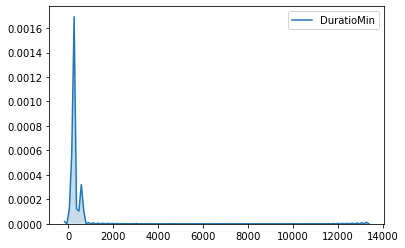

In [22]:
display(df.DuratioMin.describe())
sns.kdeplot(df.DuratioMin, shade=True, bw=60)

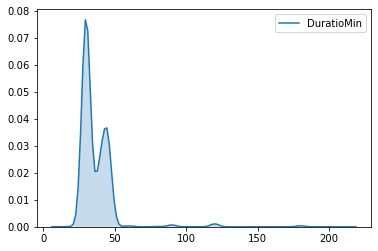

In [23]:
sns.kdeplot(df.DuratioMin[df.DuratioMin < 240], shade=True, bw=3)

**Latitude and Longitude**

In [24]:
df[['Latitude','Longitude']].head()

,Latitude,Longitude
0,7771097,-76809294
1,8108337,-76732551
2,8466042,-76598210
3,8420147,-76646490
4,8418435,-76304074


Problem with the magnitude

In [25]:
df.Latitude = df.Latitude/1000000
df.Longitude = df.Longitude/1000000

In [26]:
df[['Latitude','Longitude']].describe()

,Latitude,Longitude
count,49494.000000,49494.000000
mean,8.095747,-76.616564
std,0.379059,0.124578
min,7.198807,-76.967032
25%,7.850866,-76.713752
50%,8.082400,-76.644949
75%,8.411899,-76.549474
max,8.871278,-76.181859


**Town**

In [27]:
df[df.town.isnull()].sample(30)

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit
20497,MX_EPM_0133_DE_1568943,1568867,20,Realizada,Mto. Ener. Actividades Forestales,E_MP421,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-08-08 16:39:07,2019-07-30 11:54:00,2019-07-31 07:00:00,2019-08-28 18:00:00,2019-08-07 14:20:00,2019-08-08 06:05:05,2019-08-08 06:49:16,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,8.052640,-76.653378,3,NO APLICA,Se realizaron 4 podas y un despejes en Turbo c...,NO ESPECIFICADO,1449033784,1073159,411-41,CIRCUITO 411-41 TRAMO 411-41,NaN
14993,MX_EPM_0133_DE_1633026,1633026,5,Realizada,Mto. Ener. Actividades Forestales,E_MP264,CU-TyD-Camioneta_Poda_X4,NaT,NaT,600,PODARED01,2019-09-13 17:07:41,2019-08-21 14:40:41,2019-08-26 07:00:00,2019-09-30 18:00:00,2019-09-12 15:09:00,2019-09-13 06:30:54,2019-09-13 07:33:49,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7.777642,-76.655428,7,NO APLICA,Se realizaron 9 despejes urbano Carepa Sec. Ga...,NO ESPECIFICADO,1460289595,1124183,412-12,CIRCUITO 412-12 TRAMO 412-12,NaN
6809,MX_EPM_0133_DE_1787071,1787047,170,Realizada,Mto. Ener. Actividades Forestales,E_MP264,CU-TyD-Camioneta_Poda_X4,NaT,NaT,600,PODARED01,2019-11-12 16:55:04,2019-10-09 17:46:33,2019-10-10 07:00:00,2019-10-25 18:00:00,2019-11-11 15:46:00,2019-11-12 06:10:29,2019-11-12 06:42:29,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7.851481,-76.744262,3,NO APLICA,Se realizaron 32 Podas en el Correg. Zungo Emb...,NO ESPECIFICADO,1486069793,1260488,405-13,CIRCUITO 405-13 TRAMO 405-13,NaN
573,MX_EPM_0133_DE_2102493,2102493,1,Realizada,Mto. Ener. Actividades Forestales,E_MP244,CU-TyD-Moto_Poda_X2,NaT,NaT,540,PODARED01,2019-12-26 17:20:34,2019-12-20 16:59:42,2019-12-26 07:00:00,2019-12-26 17:00:00,2019-12-25 14:16:00,2019-12-26 06:11:22,2019-12-26 07:20:36,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7.334183,-76.530476,7,NO APLICA,Se realizaron 9 podas municipio mutatá correg....,NO ESPECIFICADO,1522647056,1445808,R2657,CIRCUITO 404-11 SEGMENTO R2657,NaN
13610,MX_EPM_0133_DE_1636189,1636189,5,Realizada,Mto. Ener. Actividades Forestales,E_MP426,CU-TyD-Camioneta_Poda_X4,NaT,NaT,600,PODARED02PLANES,2019-09-25 16:14:01,2019-08-25 11:35:52,2019-08-26 07:00:00,2019-09-27 18:00:00,2019-09-24 14:25:00,2019-09-25 06:00:24,2019-09-25 06:40:31,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,8.108165,-76.732552,7,NO APLICA,Se realizaron 19 podas y 140 despejes en el mu...,NO ESPECIFICADO,1462149123,1133770,402-14,CIRCUITO 402-14 TRAMO 402-14,NaN
15350,MX_EPM_0133_DE_1692806,1692806,1,Realizada,Mantenimiento Energía,E_D0290,CU-TyD-Moto_MttoDaños_X1,NaT,NaT,540,INSPRECORRIDORA,2019-09-11 18:17:44,2019-09-11 07:02:00,2019-09-11 07:00:00,2019-09-11 18:00:00,2019-09-11 07:05:00,2019-09-11 07:09:44,2019-09-11 08:57:15,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7.672358,-76.678352,7,NO APLICA,Se realizo inspección al circuito 403-12 en la...,NO ESPECIFICADO,1471037500,1187946,403-12,CIRCUITO 403-12 TRAMO 403-12,NaN
10574,MX_EPM_0133_DE_1821990,1821990,1,Realizada,Mantenimiento Energía,E_M0454,CU-TyD-Camioneta_Mtto_EquiEsp_Calidad,NaT,NaT,600,INSRETCABRAPRIM,2019-10-18 15:23:14,2019-10-18 07:30:43,2019-10-18 07:00:00,2019-10-18 18:00:00,2019-10-18 07:56:00,2019-10-18 07:56:40,2019-10-18 09:16:28,Uraba,Apartado TyD,AP_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,NaN,7.874473,-76.609048,7,NO APLICA,Se realizó predio en el circuito 401-42 se reg...,NO ESPECIFICADO,1490493469,1281310,401-42,CIRCUITO 401-42 TRAMO 401-42,NaN
6636,MX_EPM_0133_DE_1841291,

In [28]:
df.town = df.town.fillna('PEQUENIO CORREGIMIENTO/VEREDA')

In [29]:
df.town.value_counts()

Turbo                            10911
Necoclí                           6914
Apartadó                          6271
Carepa                            4556
San pedro de urabá                4459
Chigorodó                         4018
Arboletes                         2748
San juan de urabá                 2356
Mutatá                            1927
Currulao                          1535
Nueva Colonia                     1334
Belen de Bajira                    858
PEQUENIO CORREGIMIENTO/VEREDA      838
La Atoyosa                         658
Medellín                            24
San Pedro De Los Milagros           19
Nechí                               17
Riosucio                             9
Anzá                                 6
San José De La Montaña               5
Caucasia                             5
Olaya                                3
El Carmen De Viboral                 2
Nariño                               2
Anorí                                2
Carolina                 

**Failure Calls across time**

Text(0, 0.5, 'Number of calls')

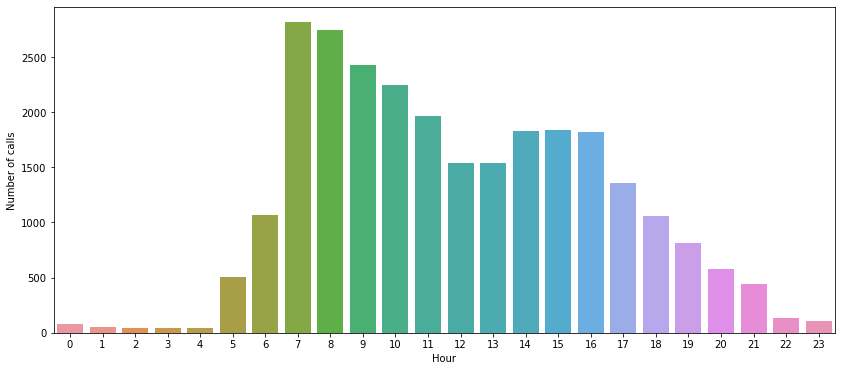

In [30]:
plt.figure(figsize=(14,6))
sns.barplot('index','OpenDate', 
            data = df[~df.CallID.duplicated()].OpenDate.dt.hour.value_counts().reset_index().sort_values('index'))
plt.xlabel('Hour')
plt.ylabel('Number of calls')

Text(0, 0.5, 'Number of Calls')

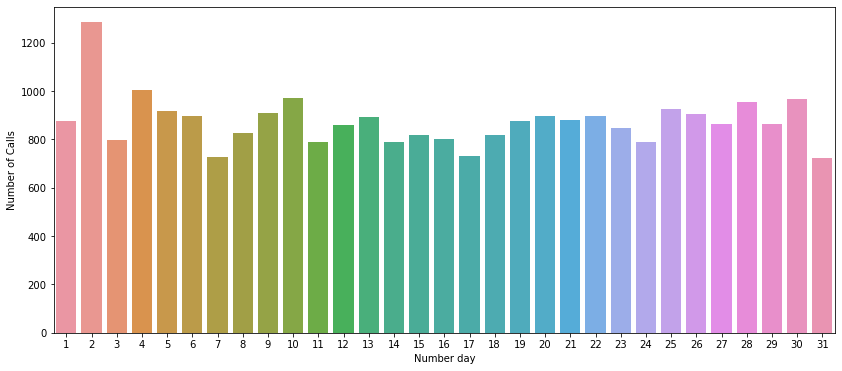

In [31]:
plt.figure(figsize=(14,6))
sns.barplot('index','OpenDate', 
            data = df[~df.CallID.duplicated()].OpenDate.dt.day.value_counts().reset_index().sort_values('index'))
plt.xlabel('Number day')
plt.ylabel('Number of Calls')


Text(0, 0.5, 'Daily mean number of Calls')

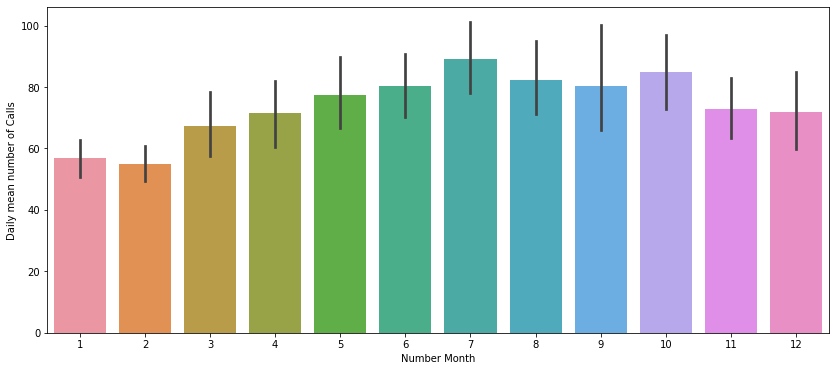

In [32]:
plt.figure(figsize=(14,6))
sns.barplot('month',0, 
            data = df[~df.CallID.duplicated()].groupby([df[~df.CallID.duplicated()].OpenDate.rename('month').dt.month,
                                                        df[~df.CallID.duplicated()].OpenDate.rename('day').dt.day]).size().\
                                     reset_index()
           )
plt.xlabel('Number Month')
plt.ylabel('Daily mean number of Calls')



In [33]:
df[~df.CallID.duplicated()].OpenDate.dt.to_period('M').value_counts().reset_index().sort_values('index')

,index,OpenDate
14,2018-06,1
13,2018-08,1
12,2018-12,20
10,2019-01,1763
11,2019-02,1542
9,2019-03,2087
8,2019-04,2145
5,2019-05,2395
4,2019-06,2406
0,2019-07,2766


Text(0, 0.5, 'Number of Calls')

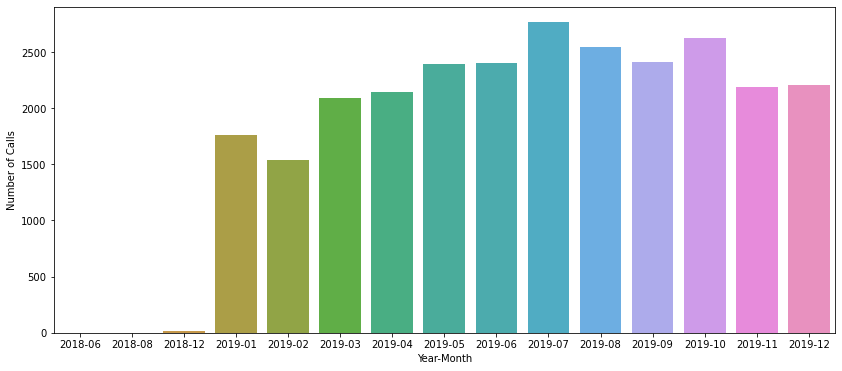

In [34]:
plt.figure(figsize=(14,6))
sns.barplot('index','OpenDate', 
            data = df[~df.CallID.duplicated()].OpenDate.dt.to_period('M').value_counts().reset_index().sort_values('index'))
plt.xlabel('Year-Month')
plt.ylabel('Number of Calls')


In [35]:
display(df[~df.CallID.duplicated()].OpenDate.dt.weekday.value_counts().reset_index().sort_values('index'))
df[~df.CallID.duplicated()].OpenDate.dt.day_name().value_counts().reset_index().sort_values('index')

,index,OpenDate
0,0,4895
1,1,4602
2,2,4461
3,3,4274
4,4,4066
5,5,2641
6,6,2163


,index,OpenDate
4,Friday,4066
0,Monday,4895
5,Saturday,2641
6,Sunday,2163
3,Thursday,4274
1,Tuesday,4602
2,Wednesday,4461


In [36]:
print('First date: ', df.OpenDate.min())
print('Last date: ', df.OpenDate.max())

First date:  2018-06-21 06:13:33
Last date:  2019-12-31 19:16:00


#### LocationDescription -> LocationResume

In [37]:
df.LocationDescription.value_counts().head(10)

Transformador                      34751
Salida Circuito                     6331
Aisladero                           2522
Reconectador                         696
Salida_Circuito                      636
CIRCUITO 412-14 SEGMENTO FR4112      125
CIRCUITO 415-12 TRAMO 415-12          95
CIRCUITO 403-16 TRAMO 403-16          82
CIRCUITO 411-13 SEGMENTO FR426        68
CIRCUITO 401-11                       66
Name: LocationDescription, dtype: int64

In [38]:
df.LocationDescription.unique()

array(['Aisladero', 'Salida Circuito', 'Transformador',
       'CIRCUITO 415-12 SEGMENTO R1269', 'CIRCUITO 411-11 TRAMO 411-11',
       'CIRCUITO 414-11 SEGMENTO FR495', 'CIRCUITO 412-11 TRAMO 412-11',
       'CIRCUITO 411-13 SEGMENTO R1299', 'CIRCUITO 403-16 TRAMO 403-16',
       'CIRCUITO 410-11', 'CIRCUITO 403-14 TRAMO 403-14',
       'CIRCUITO 407-11 SEGMENTO R2683', 'CIRCUITO 407-41 TRAMO 407-41',
       'CIRCUITO 401-16 TRAMO C41174', 'CIRCUITO 412-41 TRAMO 412-41',
       'Reconectador', 'CIRCUITO 403-16 TRAMO R887',
       'CIRCUITO 415-11 NODO 830605', 'CIRCUITO 411-13 TRAMO 411-13',
       'CIRCUITO 404-11 NODO 495253', 'CIRCUITO 404-11 NODO 495215',
       'CIRCUITO 401-11 ALIMENTADOR PRINCIPAL 401-11',
       'CIRCUITO 411-13 NODO 922276', 'CIRCUITO 403-16 TRAMO C4379',
       'CIRCUITO 415-11 NODO 488114', 'CIRCUITO 411-43',
       'CIRCUITO 404-11 TRAMO 404-11', 'CIRCUITO 411-11 TRAMO C442',
       'CIRCUITO 411-13 NODO 418175', 'CIRCUITO 411-13 SEGMENTO F4474',
       'C

In [39]:
location_d = df.LocationDescription.str.upper()
# To add Alimentador principal
location_d[location_d.str.contains('ALIMENTADOR PRINCIPAL')] = 'ALIMENTADOR PRINCIPAL'
# To unify Salida circuito
location_d[location_d=='SALIDA_CIRCUITO'] = 'SALIDA CIRCUITO'
# To add Ramal
location_d[(location_d.str.contains('RAMAL')) | (location_d.str.contains('RAMALES'))] = 'RAMAL'
# To add Tramo
location_d[location_d.str.contains('TRAMO')] = 'TRAMO'
# To add Segmento
location_d[location_d.str.contains('SEGMENTO')] = 'SEGMENTO'
# To add Nodo
location_d[location_d.str.contains('NODO')] = 'NODO'
# Plural Transformador
location_d[location_d.str.contains('TRANSFORMADORES')] = 'TRANSFORMADOR'


location_d.value_counts().head(10)

TRANSFORMADOR            34752
SALIDA CIRCUITO           6967
AISLADERO                 2522
SEGMENTO                  1524
TRAMO                     1262
RECONECTADOR               696
ALIMENTADOR PRINCIPAL      256
NODO                       254
CIRCUITO 401-11             66
CIRCUITO 409-12             59
Name: LocationDescription, dtype: int64

In [40]:
location_d[~location_d.isin(
                ['TRANSFORMADOR', 'SALIDA CIRCUITO', 'AISLADERO', 
                 'SEGMENTO', 'TRAMO', 'RECONECTADOR', 'ALIMENTADOR PRINCIPAL',
                 'NODO', 'RAMAL'] ) ].unique()

array(['CIRCUITO 410-11', 'CIRCUITO 411-43', 'CIRCUITO 404-12',
       'CIRCUITO 405-13', 'CIRCUITO 409-12', 'CIRCUITO 415-11',
       'CIRCUITO 406-11', '401-11', '400367', 'CIRCUITO 411-13',
       'REGION URABA', 'CIRCUITO 414-11', '426332', '901521', '415-13',
       'CIRCUITO 407-13', 'CIRCUITO 415-13', 'CIRCUITO 401-11',
       'CIRCUITO 401-42', '915029', '414-12', '411-11', '912325',
       'CIRCUITO 403-16', '918925', 'CIRCUITO 412-12', '452223',
       'CIRCUITO 401-15', 'CIRCUITO 405-11', '426307', 'F41290', '415-12',
       '400041', '400539', '409-12', '407-12', '402-15', '414-11',
       '407-11', 'CIRCUITO 402-16', 'CIRCUITO 412-13', 'CIRCUITO 412-14',
       'CIRCUITO 404-11', 'CIRCUITO 411-11', 'CIRCUITO 401-41', 'F41556',
       'F41257', '402-13', 'FR4322', '915441', 'CIRCUITO 411-41',
       'CIRCUITO 414-12', '818510', '465027', 'SWITCH', 'CIRCUITO 411-42',
       '827755', '903670', 'CIRCUITO 411-12', 'CIRCUITO 415-12',
       'CIRCUITO 411-44', 'CIRCUITO 407-41',

In [41]:
location_d[~location_d.isin(
                ['TRANSFORMADOR', 'SALIDA CIRCUITO', 'AISLADERO', 
                 'SEGMENTO', 'TRAMO', 'RECONECTADOR', 'ALIMENTADOR PRINCIPAL',
                 'NODO', 'RAMAL'] ) ] = 'NO ESPECIFICADO'


In [42]:
# New variable
df['LocationResume'] = location_d
del(location_d)

In [43]:
df.LocationResume.value_counts()

TRANSFORMADOR            34752
SALIDA CIRCUITO           6967
AISLADERO                 2522
SEGMENTO                  1524
TRAMO                     1262
NO ESPECIFICADO           1228
RECONECTADOR               696
ALIMENTADOR PRINCIPAL      256
NODO                       254
RAMAL                       33
Name: LocationResume, dtype: int64

Text(0.5, 1.0, 'Time of repair')

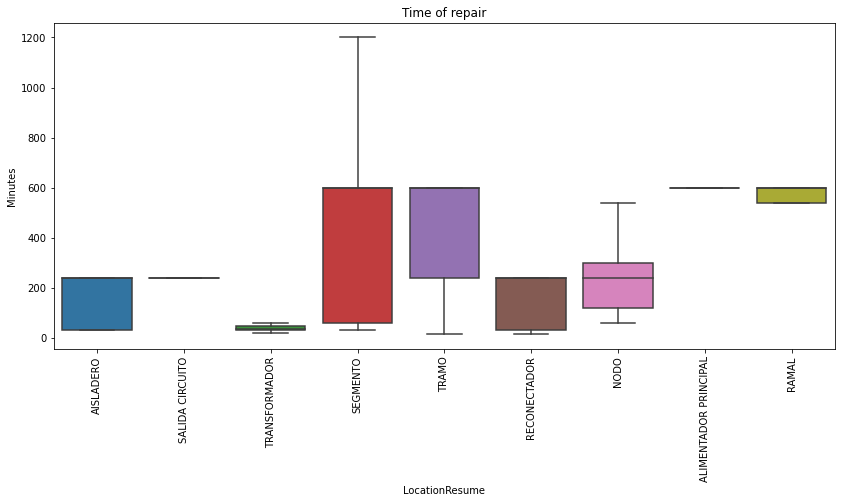

In [44]:
plt.figure(figsize=(14,6))
sns.boxplot('LocationResume','DuratioMin', data=df[df.LocationResume!='NO ESPECIFICADO'],
            showfliers=False)
plt.xticks(rotation=90)
plt.ylabel('Minutes')
plt.title('Time of repair')

In [45]:

LocRes_WO = df[~df[['CallID','NumberOT']].duplicated()].LocationResume[df.LocationResume!='NO ESPECIFICADO'].\
                value_counts().reset_index().copy()
LocRes_WO.to_csv('Outputs/locres_wo.csv')
fig2 = px.pie(LocRes_WO, values='LocationResume', names='index', title='Failure components ditribution')
fig2.update_traces(textinfo='percent+label')
fig2.show()

#### Circuit revision

In [46]:
df.Circuit.value_counts()
df.Circuit.isnull().value_counts()

False    44938
True      4556
Name: Circuit, dtype: int64

In [47]:
df[df.Circuit.isnull()][['LocationID','LocationDescription','Circuit']]

,LocationID,LocationDescription,Circuit
3,R1269,CIRCUITO 415-12 SEGMENTO R1269,NaN
5,411-11,CIRCUITO 411-11 TRAMO 411-11,NaN
8,FR495,CIRCUITO 414-11 SEGMENTO FR495,NaN
10,412-11,CIRCUITO 412-11 TRAMO 412-11,NaN
13,R1299,CIRCUITO 411-13 SEGMENTO R1299,NaN
...,...,...,...
48089,934067,CIRCUITO 411-13 NODO 934067,NaN
48123,NaN,FR476,NaN
48145,NaN,FR476,NaN
48271,NaN,404-12,NaN


In [48]:
# Some missings can be fill with a pattern "ddd-dd" in LocationDescription

df.Circuit = df.Circuit.fillna(df.LocationDescription.apply(lambda x: re.findall(r'\d\d\d-\d\d', x)[0] 
                                     if len(re.findall(r'\d\d\d-\d\d', x)) > 0 
                                     else 'NO ESPECIFICADO' ))
df.Circuit.isnull().value_counts()

False    49494
Name: Circuit, dtype: int64

In [49]:
(df.Circuit=='NO ESPECIFICADO').value_counts()

False    49255
True       239
Name: Circuit, dtype: int64

In [50]:
df[df.LocationResume=='TRANSFORMADOR'][['LocationID','LocationDescription','Circuit']]

,LocationID,LocationDescription,Circuit
2,489023,Transformador,415-12
4,478088,Transformador,407-12
6,492051,Transformador,415-13
7,492042,Transformador,415-13
9,828025,Transformador,402-14
...,...,...,...
49488,64835,Transformador,401-16
49489,905933,Transformador,412-13
49490,482044,Transformador,409-11
49491,482044,Transformador,409-11


#### LocationId

In [51]:
df.LocationID.isnull().sum()

572

In [52]:
df[df.LocationID.isnull()][['LocationDescription','Circuit','LocationResume']].sample(5)

,LocationDescription,Circuit,LocationResume
14627,402-12,402-12,NO ESPECIFICADO
34161,402-12,402-12,NO ESPECIFICADO
31886,401-11,401-11,NO ESPECIFICADO
36554,482002,NO ESPECIFICADO,NO ESPECIFICADO
2332,426332,NO ESPECIFICADO,NO ESPECIFICADO


In [53]:
df.LocationID = df.LocationID.fillna(df.LocationDescription.apply(lambda x: re.findall(r'\w?\w?\d\d\d\d?\d?\d?', x)[0] 
                                     if len(re.findall(r'\w?\w?\d\d\d\d?\d?\d?', x)) > 0 
                                     else 'NO ESPECIFICADO'))

df.LocationID = df.LocationID.str.replace(r'\d\d\d-\d\d', 'NO ESPECIFICADO',regex=True)

In [54]:
(df.LocationID=='NO ESPECIFICADO').sum()

8805

In [55]:
df[df.LocationID=='NO ESPECIFICADO'][['LocationDescription','Circuit','LocationResume']]

,LocationDescription,Circuit,LocationResume
1,Salida Circuito,402-11,SALIDA CIRCUITO
5,CIRCUITO 411-11 TRAMO 411-11,411-11,TRAMO
10,CIRCUITO 412-11 TRAMO 412-11,412-11,TRAMO
15,Salida Circuito,415-11,SALIDA CIRCUITO
16,Salida Circuito,415-11,SALIDA CIRCUITO
...,...,...,...
49436,Salida Circuito,411-13,SALIDA CIRCUITO
49437,Salida Circuito,411-13,SALIDA CIRCUITO
49442,Salida Circuito,404-12,SALIDA CIRCUITO
49457,Salida Circuito,411-13,SALIDA CIRCUITO


#### Crew general comments

In [56]:
#To lowercase
df.CrewGeneralComments = df.CrewGeneralComments.str.lower()

In [57]:
print('Unique values:',len(df.CrewGeneralComments.unique()))
print('Duplicates Crew General Comments:', df.CrewGeneralComments.duplicated().value_counts()[1])

print('\n --- Head ---')
print(df.CrewGeneralComments.value_counts().head())
print('\n --- Tail ---')
print(df.CrewGeneralComments.value_counts().tail())

Unique values: 37867
Duplicates Crew General Comments: 11627

 --- Head ---
duplicada                                                                                                                                                                                                                                                                                                                                                                                                                             21
se desbloquea medidor prepago quedó él servicio normal                                                                                                                                                                                                                                                                                                                                                                                21
se repara linea secundaria rota no se afecta el transformador queda usuari

In [58]:
df[df.CrewGeneralComments.duplicated()].CrewGeneralComments

16       se instaló 500 mt de triples 1/0 para remplaza...
17       se instaló 500 mt de triples 1/0 para remplaza...
18       se instaló 500 mt de triples 1/0 para remplaza...
21       se retiro 200 metros de ascr # 2 y se instalar...
22       se retiro 200 metros de ascr # 2 y se instalar...
                               ...                        
49476             se reparo cable de señal servicio normal
49481    circuito 415-11. se instalaron conectores en r...
49484    se yego al sitio y se encontró vivienda  con o...
49491    se yego al sitio y se encontró trasformador de...
49492    se yego al sitio y se encontró trasformador de...
Name: CrewGeneralComments, Length: 11627, dtype: object

Find Key Words in "Comments"

In [59]:
#find frequency of words in CrewGeneralComments and print important ones, excluiding articles or prepositions

palabrasx=['se','de','y','Se','el','en','la','con','a','por','no','SE','que','las','al','para','del','DE','queda','Y','le','los','un','ya','2','esta','sin']
guardar = pd.DataFrame(columns=['palabras','row'])  

for row in range(0,999):
       if not (pd.isnull(df['CrewGeneralComments'][row])):
                data_set = df['CrewGeneralComments'][row]
                split_it = data_set.split() 
                splitDF = pd.DataFrame(split_it,columns=['palabras'])
                splitDF["row"]=row
                guardar= pd.concat([guardar, splitDF])
print(guardar.shape)
guardarb=guardar[guardar['palabras'].isin(palabrasx)==False]
print(guardarb.shape)

(29658, 2)
(18929, 2)


In [60]:
aa=guardarb.groupby("palabras")["palabras"].count()
aa.sort_values(ascending=False).head(50)

palabras
servicio         668
fusible          300
medidor          254
normal           235
trafo            212
usuario          202
verifica         182
encontró         149
encuentra        148
cambio           144
cambia           139
ruta             124
energía          118
prepago          114
usuarios         112
poste            112
normal.          107
transformador     99
apoyo             98
normalizado       95
secundaria        92
linea             85
evento            83
f                 82
quemado           82
circuito          82
pendiente         80
acometida         79
repara            77
red               77
lluvias           74
este              71
quedó             71
fuertes           67
alas              66
sector            66
lo                65
cliente           64
energizó          62
revisa            62
reparo            61
fue               61
teclado           58
cambió            58
primaria          58
realizaron        58
#                 57
sobr

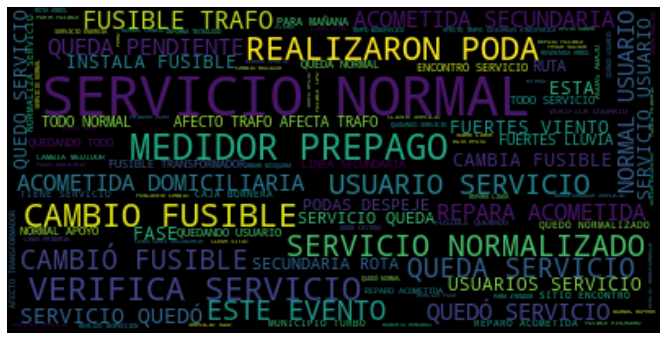

In [61]:
df["CrewGeneralCommentsString"] = df["CrewGeneralComments"].str.upper().astype(str)
df.head()

text = (" ".join(list(df["CrewGeneralCommentsString"].unique()))).replace('/',' ')
#text

palabrasx2 = ['RAMAL RAMALES', 'PARA']
# Create and generate a word cloud image:
wordcloud_CGC = WordCloud(min_word_length=4,collocations=True, relative_scaling=0.5,
                        stopwords=palabrasx2).generate(text)

# Display the generated image:
plt.figure(figsize=(14,6))
plt.imshow(wordcloud_CGC, interpolation='bilinear')
plt.axis("off")
plt.show()


In [62]:
#Remove accendts functions
def remove_accents(s):
    replace = [
        ['á','a'], ['é','e'], ['í','i'], ['ó','o'], ['ú','u']
    ]
    for a, b in replace:
        s = s.str.replace(a,b).str.replace(a.upper(),b.upper())
    return s


**Service type and priority**

,index,ServiceType
0,Daños Energía,33224
1,Mantenimiento Energía,14321
2,Mto. Ener. Actividades Forestales,1695
3,Mantenimiento Línea Viva,240
4,Mantenimiento Subterránea,14


Priority,1,2,3,4,5,7,9
ServiceType,,,,,,,
Daños Energía,11872,5803,4657,10843,26,23,0
Mantenimiento Energía,16,129,525,0,37,1219,12395
Mantenimiento Línea Viva,0,23,0,0,13,204,0
Mantenimiento Subterránea,1,1,0,0,0,12,0
Mto. Ener. Actividades Forestales,0,2,1032,0,3,658,0



It seems that cases with lesser priority are solved with maintenance activities,
that could explain why cases with priority nine have more number of calls



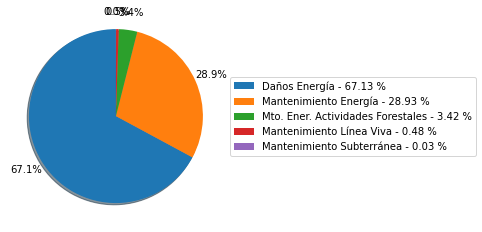

In [63]:
num_service_type=df["ServiceType"].value_counts().reset_index()
display(num_service_type)

num_service_type["Percentage"] = num_service_type["ServiceType"]/num_service_type["ServiceType"].sum()
labelst = ['{} - {:.2f} %'.format(num_service_type['index'][i],num_service_type["Percentage"][i]*100)
           for i in range(len(num_service_type))]
ss=plt.pie(num_service_type["ServiceType"],shadow=True, startangle=90, 
           autopct='%1.1f%%', pctdistance = 1.2)
plt.legend(labels=labelst, loc='center left', bbox_to_anchor=(1, 0.5))


display(pd.crosstab(df.ServiceType,df.Priority))

analysis4="""
It seems that cases with lesser priority are solved with maintenance activities,
that could explain why cases with priority nine have more number of calls
"""
print(analysis4)




In [64]:
num_repar_ot=df["NumberOT"].value_counts().reset_index() #Number of reprisons OT
fig = px.box(num_repar_ot, y="NumberOT",notched=True, title="Box plot of Number of reparations per Work order")
fig.show()
display(num_repar_ot["NumberOT"].describe(percentiles=[.25, .5, .75, 0.76, 0.77]).reset_index()) #descriptives statistics of number of reparisons

num_calls_ot_pri=df[["CallID", "NumberOT","Priority"]].groupby(["NumberOT","Priority"]).count().reset_index()
fig1 = px.box(num_calls_ot_pri, x="Priority", y="CallID",color="Priority",notched=True, title="Box plot of Number of reparations per CallID")
fig1.show()

fig2 = px.pie(num_service_type, values='ServiceType', names='index', title='Pie chart of the number of reparations by type of service')
fig2.update_traces(textinfo='percent+label')
fig2.show()

,index,NumberOT
0,count,38602.000000
1,mean,1.282162
2,std,0.740049
3,min,1.000000
4,25%,1.000000
5,50%,1.000000
6,75%,1.000000
7,76%,1.000000
8,77%,1.000000
9,max,15.000000


**Location of failures by priority**

In [65]:
#priority_col_dict
#Mejorar los colores, función para cada RGB
df.Priority.unique()
priority_colors = ['#%02x%02x%02x' % (255, 0+(i*30), 0) for i in range(len(df.Priority.unique()))]
priority_colors = list(reversed(priority_colors))
priority_col_dict = dict(zip(df.Priority.unique(),priority_colors[-1::-1]))

#Center in Apartadó, Antioquia: (7.88299, -76.62587)
antioquia_map2 = folium.Map(location=[7.88299, -76.62587],
                        zoom_start=9,
                        tiles='openstreetmap')

for i in range(0,len(df)):
    marker = folium.CircleMarker(location=[ df["Latitude"][i], df["Longitude"][i] ],
                                 radius=2,
                                 color= priority_col_dict[df.Priority[i]],
                                 fill=True)
    marker.add_to(antioquia_map2)


antioquia_map2

--------------------

# Review to make the relational model

Filter 2019 data.

In [66]:
df_filter = df[df.OpenDate.dt.year==2019].copy()
print('Filter rows:',len(df_filter))
print('Originak rows:',len(df))

Filter rows: 49460
Originak rows: 49494


In [67]:
# Drop original to free memory.
del(df)

In [68]:
df_filter.isnull().sum()

CallID                          0
NumberOT                        0
TaskNumber                      0
Status                          0
ServiceType                     0
id                              0
Eng_Type                        0
RepairDate                   6375
FinalRepairDate              6423
DuratioMin                      0
TaskType                        0
CompletionDate                  0
OpenDate                        0
EarlyStart                      0
DueDate                         4
DispatchDate                   25
TravelDate                     18
OnSiteDate                   1602
Region                          0
District                        0
TreeServiceGroup                0
ServiceGroup                    0
BusinessLine                    0
town                            0
Latitude                        0
Longitude                       0
Priority                        0
IncompleteReason                0
CrewGeneralComments            94
RepairCode    

In [69]:
df_filter.head()

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,RepairDate,FinalRepairDate,DuratioMin,TaskType,CompletionDate,OpenDate,EarlyStart,DueDate,DispatchDate,TravelDate,OnSiteDate,Region,District,TreeServiceGroup,ServiceGroup,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,W6Key,IdEPM,LocationID,LocationDescription,Circuit,LocationResume,CrewGeneralCommentsString
0,M_EPM_EN_3974557,3294596,1,Realizada,Daños Energía,E_D0239,CU-TyD-Moto_MttoDaños_X1,2019-12-31 19:24:00,2019-12-31 19:30:00,30,TRABAJOFUSIBLE,2019-12-31 19:53:55,2019-12-31 19:16:00,2019-12-31 19:16:00,2019-12-31 20:00:00,2019-12-31 19:17:00,2019-12-31 19:17:00,2019-12-31 19:24:06,Uraba,Apartado TyD,AP_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Carepa,7.771097,-76.809294,1,NO APLICA,se realizo reposición de fusible en el fr 4159...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1527996425,1460157,FR4159,Aisladero,405-13,AISLADERO,SE REALIZO REPOSICIÓN DE FUSIBLE EN EL FR 4159...
1,M_EPM_EN_3974642,3294347,1,Realizada,Daños Energía,E_D0264,CU-TyD-Moto_MttoDaños_X1,2019-12-31 17:59:00,2019-12-31 18:23:00,30,INSPECQOS,2019-12-31 18:42:16,2019-12-31 10:23:53,2019-12-31 10:23:00,2019-12-31 18:23:00,2019-12-31 11:07:00,2019-12-31 17:46:12,2019-12-31 17:52:35,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Turbo,8.108337,-76.732551,4,NO APLICA,se llega a el cirio y se encuentra que el daño...,REVISIÓN POR CALIDAD DEL SERVICIO,1527808009,1459416,NO ESPECIFICADO,Salida Circuito,402-11,SALIDA CIRCUITO,SE LLEGA A EL CIRIO Y SE ENCUENTRA QUE EL DAÑO...
2,M_EPM_EN_3974707,3294568,2,Realizada,Daños Energía,E_D0223,CU-TyD-Moto_MttoDaños_X1,2019-12-31 17:57:00,2019-12-31 17:59:00,30,INSPECQOS,2019-12-31 18:16:57,2019-12-31 17:46:00,2019-12-31 17:46:00,2020-01-03 17:37:00,2019-12-31 17:48:00,2019-12-31 17:54:36,2019-12-31 17:55:35,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,Necoclí,8.466042,-76.598210,4,NO APLICA,se realizó inspección encontrándose poste a pu...,CAMBIAR/ASEGURAR POSTE PRIMARIO - Ramales,1527955467,1460101,489023,Transformador,415-12,TRANSFORMADOR,SE REALIZÓ INSPECCIÓN ENCONTRÁNDOSE POSTE A PU...
3,MX_EPM_0133_DE_2037523,2037523,1,Realizada,Mto. Ener. Actividades Forestales,E_MP219,CU-TyD-Moto_Poda_X2,NaT,NaT,600,PODARED01,2019-12-31 18:10:00,2019-12-10 08:40:00,2019-12-27 07:00:00,2019-12-27 17:00:00,2019-12-30 14:55:00,2019-12-31 07:11:00,2019-12-31 07:18:00,Uraba,Turbo TyD,TU_TyD Mantenimiento,TyD Mantenimiento,Mantenimiento TyD,Necoclí,8.420147,-76.646490,7,NO APLICA,corregimiento pueblo nuevo \nvereda comarca ...,NO ESPECIFICADO,1517256747,1419179,R1269,CIRCUITO 415-12 SEGMENTO R1269,415-12,SEGMENTO,CORREGIMIENTO PUEBLO NUEVO \nVEREDA COMARCA ...
4,M_EPM_EN_3974852,3294520,1,Realizada,Daños Energía,E_D0270,CU-TyD-Moto_MttoDaños_X1,2019-12-31 16:52:00,2019-12-31 17:07:00,30,TRABAJOFUSIBLE,2019-12-31 18:02:33,2019-12-31 15:38:00,2019-12-31 15:38:00,2019-12-31 23:36:00,2019-12-31 15:40:00,2019-12-31 15:47:37,2019-12-31 16:48:53,Uraba,Turbo TyD,TU_TyD Atención Clientes,TyD Atención Clientes,Daños TyD,San pedro de urabá,8.418435,-76.304074,1,NO APLICA,se repuso 1 fusible de 6t al f47910 el servici...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1527922700,1460058,478088,Transformador,407-12,TRANSFORMADOR,SE REPUSO 1 FUSIBLE DE 6T AL F47910 EL SERVICI...


Drop all date variables except `OpenDate`, because is the date when the failure is reported; and `Region` because we only have data from one region, Urabá. Aditionaly, `TreeServiceGroup`, `ServiceGroup` and `BUsinessLine` provide similar information, but this last is clearer. `W6Key` have not explanation and describe the same that `IdEpm`. Finally, `LocationDescription` was used to fill missing values in other variables and to create de new `LocationResume`, now is unnecessary.

In [70]:
# Drop unnecesary columns
df_filter = df_filter.drop(columns=['CompletionDate','RepairDate','FinalRepairDate','DueDate','DispatchDate','TravelDate', 
                                    'OnSiteDate','EarlyStart','Region','TreeServiceGroup','ServiceGroup',
                                    'CrewGeneralCommentsString','W6Key','LocationDescription'])
df_filter.head(3)

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
0,M_EPM_EN_3974557,3294596,1,Realizada,Daños Energía,E_D0239,CU-TyD-Moto_MttoDaños_X1,30,TRABAJOFUSIBLE,2019-12-31 19:16:00,Apartado TyD,Daños TyD,Carepa,7.771097,-76.809294,1,NO APLICA,se realizo reposición de fusible en el fr 4159...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1460157,FR4159,405-13,AISLADERO
1,M_EPM_EN_3974642,3294347,1,Realizada,Daños Energía,E_D0264,CU-TyD-Moto_MttoDaños_X1,30,INSPECQOS,2019-12-31 10:23:53,Turbo TyD,Daños TyD,Turbo,8.108337,-76.732551,4,NO APLICA,se llega a el cirio y se encuentra que el daño...,REVISIÓN POR CALIDAD DEL SERVICIO,1459416,NO ESPECIFICADO,402-11,SALIDA CIRCUITO
2,M_EPM_EN_3974707,3294568,2,Realizada,Daños Energía,E_D0223,CU-TyD-Moto_MttoDaños_X1,30,INSPECQOS,2019-12-31 17:46:00,Turbo TyD,Daños TyD,Necoclí,8.466042,-76.598210,4,NO APLICA,se realizó inspección encontrándose poste a pu...,CAMBIAR/ASEGURAR POSTE PRIMARIO - Ramales,1460101,489023,415-12,TRANSFORMADOR


In [71]:
df_filter.isnull().sum()

CallID                  0
NumberOT                0
TaskNumber              0
Status                  0
ServiceType             0
id                      0
Eng_Type                0
DuratioMin              0
TaskType                0
OpenDate                0
District                0
BusinessLine            0
town                    0
Latitude                0
Longitude               0
Priority                0
IncompleteReason        0
CrewGeneralComments    94
RepairCode              0
IdEPM                   0
LocationID              0
Circuit                 0
LocationResume          0
dtype: int64

In [72]:
# To indicate missings in CrewGeneralComments
display(df_filter[df_filter.CrewGeneralComments.isnull()].head(20))

df_filter.CrewGeneralComments = df_filter.CrewGeneralComments.fillna('NO ESPECIFICADO')

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
3272,M_EPM_EN_3953390,3275191,2,Realizada,Daños Energía,E_D0270,CU-TyD-Moto_MttoDaños_X1,45,ATEMEDATC,2019-12-05 18:23:16,Turbo TyD,Daños TyD,San pedro de urabá,8.279036,-76.383691,4,NO APLICA,NaN,ASEGURAR/REPARAR ACOMETIDAS DOMICILIARIAS,1405065,476010,407-11,TRANSFORMADOR
3273,M_EPM_EN_3953390,3275191,2,Realizada,Daños Energía,E_D0270,CU-TyD-Moto_MttoDaños_X1,45,ATEMEDATC,2019-12-05 18:23:16,Turbo TyD,Daños TyD,San pedro de urabá,8.279036,-76.383691,4,NO APLICA,NaN,CAMBIAR/INSTALAR CONECTOR EN LA RED SECUNDARIA,1405065,476010,407-11,TRANSFORMADOR
29722,M_EPM_EN_3738411,3100391,2,No Realizada,Mantenimiento Energía,E_M0261,CU-TyD-Camioneta_Mtto_X3,240,EVENTOPROGRAM,2019-06-11 19:03:57,Turbo TyD,Mantenimiento TyD,Necoclí,8.419443,-76.589687,9,TyD_594_Fuerza Mayor,NaN,NO APLICA,957588,915476,415-12,TRANSFORMADOR
30488,M_EPM_EN_3733733,3095727,2,No Realizada,Daños Energía,E_M0261,CU-TyD-Camioneta_Mtto_X3,30,INSPECSEGURIDAD,2019-06-06 21:38:12,Turbo TyD,Daños TyD,Turbo,8.067648,-76.660563,1,TyD_624_Servicio Normal,NaN,NO APLICA,942472,418184,411-13,TRANSFORMADOR
30825,M_EPM_EN_3731129,3093057,1,No Realizada,Daños Energía,E_D0217,CU-TyD-Moto_MttoDaños_X1,30,TRABAJOFUSIBLE,2019-06-04 16:53:39,Turbo TyD,Daños TyD,Arboletes,8.808104,-76.400113,1,TyD_594_Fuerza Mayor,NaN,NO APLICA,934849,918166,409-12,TRANSFORMADOR
31309,M_EPM_EN_3727025,3089718,1,No Realizada,Daños Energía,E_D0227,CU-TyD-Moto_MttoDaños_X1,45,ATEMEDATC,2019-05-31 18:07:56,Turbo TyD,Daños TyD,Apartadó,7.904000,-76.738153,4,TyD_595_Requiere otro tipo de cuadrilla,NaN,NO APLICA,925925,750409,406-11,TRANSFORMADOR
31775,M_EPM_EN_3723828,3086910,1,No Realizada,Daños Energía,E_D0270,CU-TyD-Moto_MttoDaños_X1,30,TRABAJOFUSIBLE,2019-05-29 11:19:00,Turbo TyD,Daños TyD,San pedro de urabá,8.252910,-76.305917,2,TyD_626_Cancelado por el despacho,NaN,NO APLICA,920174,935463,407-12,TRANSFORMADOR
32037,M_EPM_EN_3715730,3080210,1,No Realizada,Daños Energía,E_D0415,CU-TyD-Moto_MttoDaños_X1,45,ATEMEDATC,2019-05-23 10:36:24,Turbo TyD,Daños TyD,San pedro de urabá,8.276212,-76.379415,4,TyD_626_Cancelado por el despacho,NaN,NO APLICA,905312,476025,407-12,TRANSFORMADOR
32038,M_EPM_EN_3721013,3084289,1,No Realizada,Daños Energía,E_D0415,CU-TyD-Moto_MttoDaños_X1,45,ATEMEDATC,2019-05-27 10:06:24,Turbo TyD,Daños TyD,San pedro de urabá,8.273107,-76.377000,4,TyD_626_Cancelado por el despacho,NaN,NO APLICA,917628,476041,407-12,TRANSFORMADOR
33014,M_EPM_EN_3710633,3076696,1,No Realizada,Mantenimiento Energía,E_M0211,CU-TyD-Camioneta_Mtto_X4,240,EVENTOPROGRAM,2019-05-20 14:51:03,Apartado TyD,Mantenimiento TyD,Mutatá,7.485737,-76.555327,9,TyD_626_Cancelado por el despacho,NaN,NO APLICA,895352,F4639,404-12,AISLADERO


In [73]:
df_filter.isnull().sum().sum()

0

## Split failures data frame

In [74]:
df_filter.shape

(49460, 23)

In [75]:
#27081
len(df_filter.CallID.unique())
df_filter.sort_values(['CallID','TaskNumber']).head(10)

,CallID,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
42259,MX_EPM_0133_DE_1027521,1027521,1,Realizada,Mantenimiento Línea Viva,E_LV0070,CU-TyD-Canasta Tipo II,120,TRABSECCIOLV,2019-03-13 09:12:00,Turbo TyD,Mantenimiento TyD,Turbo,8.108278,-76.732553,7,NO APLICA,hora de inicio 7:00.se cambiaron espaciadores ...,NO ESPECIFICADO,721913,NO ESPECIFICADO,402-12,NO ESPECIFICADO
40758,MX_EPM_0133_DE_1048602,1048602,1,Realizada,Mantenimiento Energía,E_LV0026,CU-TyD-Canasta Tipo I,120,PODARESPVEGETALESLV,2019-03-23 07:11:00,Turbo TyD,Mantenimiento TyD,San juan de urabá,8.755187,-76.517909,7,NO APLICA,se talo árbol que ofrecía peligro con el circuito,NO ESPECIFICADO,747341,497039,409-12,NODO
40362,MX_EPM_0133_DE_1063105,1063105,1,Realizada,Mantenimiento Línea Viva,E_LV0051,CU-TyD-Canasta Tipo II,120,TRASVESPOSTELV,2019-03-27 07:13:00,Turbo TyD,Mantenimiento TyD,Turbo,8.208380,-76.521975,7,NO APLICA,se cambian barras y se mejoran conexiones en e...,NO ESPECIFICADO,765042,F43291,410-11,SEGMENTO
37280,MX_EPM_0133_DE_1187880,1187880,1,Realizada,Mantenimiento Energía,E_LV0030,CU-TyD-Canasta Tipo II,120,PODARESPVEGETALESLV,2019-04-18 10:45:00,Turbo TyD,Mantenimiento TyD,Arboletes,8.616382,-76.516446,7,NO APLICA,se desocupó árbol sobre la línea queda pendien...,NO ESPECIFICADO,812998,910191,414-11,NODO
11677,MX_EPM_0133_DE_1213071,1213071,1,Realizada,Mantenimiento Línea Viva,E_D0297,CU-TyD-Moto_MttoDaños_X1,120,TRABSECCIOLV,2019-04-26 13:54:17,Apartado TyD,Mantenimiento TyD,Apartadó,7.873326,-76.619438,7,NO APLICA,este evento sera atendido por linea viva favor...,NO ESPECIFICADO,832087,C41623,401-17,TRAMO
1144,MX_EPM_0133_DE_1213363,1213363,1,No Realizada,Mantenimiento Línea Viva,E_LV0050,CU-TyD-Canasta Tipo I,75,TRABSECCIOLV,2019-04-26 11:11:00,Turbo TyD,Mantenimiento TyD,Turbo,8.208213,-76.521719,7,TyD_626_Cancelado por el despacho,se cancela por vencimiento de terminos,NO APLICA,835101,NO ESPECIFICADO,411-44,TRAMO
1146,MX_EPM_0133_DE_1213747,1213747,1,No Realizada,Mantenimiento Línea Viva,E_LV0030,CU-TyD-Canasta Tipo II,360,TRASVESPOSTELV,2019-04-26 11:36:00,Apartado TyD,Mantenimiento TyD,Carepa,7.823233,-76.721918,7,TyD_626_Cancelado por el despacho,se cancela por vencimiento de terminos,NO APLICA,834907,C4474,405-11,TRAMO
34908,MX_EPM_0133_DE_1213832,1213832,1,Realizada,Mantenimiento Línea Viva,E_LV0051,CU-TyD-Canasta Tipo II,360,TRASVESPOSTELV,2019-04-26 11:53:00,Turbo TyD,Mantenimiento TyD,Turbo,7.997584,-76.638404,7,NO APLICA,"se hace referencia 3f ,se instalan cuchillas ...",NO ESPECIFICADO,832485,F4372,411-12,SEGMENTO
34581,MX_EPM_0133_DE_1214124,1214124,1,Realizada,Mantenimiento Línea Viva,E_LV0051,CU-TyD-Canasta Tipo II,360,TRASVESPOSTELV,2019-04-26 14:05:00,Apartado TyD,Mantenimiento TyD,Apartadó,7.883908,-76.622539,7,NO APLICA,se acoplan y conectan cuchillas de by pas se a...,NO ESPECIFICADO,835569,426204,401-12,NODO
10343,MX_EPM_0133_DE_1214149,1214149,1,Realizada,Mantenimiento Línea Viva,E_D0238,CU-TyD-Moto_MttoDaños_X1,360,TRASVESPOSTELV,2019-04-26 14:04:00,Apartado TyD,Mantenimiento TyD,Mutatá,7.349290,-76.546405,7,NO APLICA,se recogió potencia con la grua en el despacho...,NO ESPECIFICADO,831773,F4228,404-12,SEGMENTO


Which variables make a unique identifier.

In [76]:
df_filter.groupby(['CallID', 'NumberOT', 'TaskNumber','RepairCode']).count().agg([max,'mean'])

,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,IdEPM,LocationID,Circuit,LocationResume
max,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
mean,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


Variables `CallID, NumberOT, TaskNumber and RepairCode` make a primary key.

Next, we are going to find the right division of the data.

In [77]:
%%time
# First filter by rows with duplicate CallID
# Group by CallID and calculate the number of diferent values in each variable by CallID
df_filter[df_filter.CallID.duplicated(keep=False)].groupby('CallID').agg(lambda y: len(y.unique())).agg([max, 'mean'])

Wall time: 34.6 s


,NumberOT,TaskNumber,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
max,114.000000,114.000000,2.000000,2.000000,24.000000,6.00000,3.000000,4.000000,94.0000,2.000000,2.000000,4.000000,3.000000,3.000000,3.000000,4.00000,106.000000,20.000000,114.000000,3.000000,2.000000,3.000000
mean,2.321999,2.322229,1.163584,1.175991,1.713153,1.23251,1.194601,1.201723,2.0139,1.001149,1.175876,1.101436,1.042734,1.042619,1.211258,1.18162,2.308443,2.557611,2.322229,1.058013,1.015508,1.065594


In [78]:
%%time
# First filter by rows with duplicate CallID
# Group by NumberOT and calculate the number of diferent values in each variable by NumberOT
df_filter[df_filter.CallID.duplicated(keep=False)].groupby('NumberOT').agg(lambda y: len(y.unique())).agg([max,'mean'])

Wall time: 1min 13s


,CallID,TaskNumber,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
max,1.0,2.000000,1.0,1.0,2.000000,1.0,1.0,1.0,2.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.000000,15.000000,2.000000,1.0,1.0,1.0
mean,1.0,1.000099,1.0,1.0,1.000049,1.0,1.0,1.0,1.000099,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.000099,1.537723,1.000099,1.0,1.0,1.0


In [79]:
%%time
# First filter by rows with duplicate CallID
# Group by NumberOT and TaskNumber and calculate the number of diferent values in each variable and group
df_filter[df_filter.CallID.duplicated(keep=False)].groupby(['NumberOT', 'TaskNumber']).\
            agg(lambda y: len(y.unique())).agg([max,'mean'])

Wall time: 1min 8s


,CallID,Status,ServiceType,id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,town,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume
max,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,15.00000,1.0,1.0,1.0,1.0
mean,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.53767,1.0,1.0,1.0,1.0


Its necessary explain how choose the variables to each table.

In [80]:
# Make a clearer and informative name.
df_filter.rename(columns={'id':'Troop_id', 'town':'Municipio'}, inplace=True)

# Municipio to upper
df_filter.Municipio = df_filter.Municipio.str.upper()

**Split data frames**

Key to join new tables.

In [81]:
# Is necessary create a identifier code by ('CallID', 'NumberOT')
#df_filter[['CallID', 'NumberOT']].sample(5)
df_filter['CallOtID'] = df_filter.CallID.str.extract('.*(\d{7})')[0].str.cat(df_filter.NumberOT.apply(str), sep='-', na_rep='')
df_filter.head(2)

,CallID,NumberOT,TaskNumber,Status,ServiceType,Troop_id,Eng_Type,DuratioMin,TaskType,OpenDate,District,BusinessLine,Municipio,Latitude,Longitude,Priority,IncompleteReason,CrewGeneralComments,RepairCode,IdEPM,LocationID,Circuit,LocationResume,CallOtID
0,M_EPM_EN_3974557,3294596,1,Realizada,Daños Energía,E_D0239,CU-TyD-Moto_MttoDaños_X1,30,TRABAJOFUSIBLE,2019-12-31 19:16:00,Apartado TyD,Daños TyD,CAREPA,7.771097,-76.809294,1,NO APLICA,se realizo reposición de fusible en el fr 4159...,CAMBIAR O INSTALAR FUSIBLE AISLADERO RAMAL - R...,1460157,FR4159,405-13,AISLADERO,3974557-3294596
1,M_EPM_EN_3974642,3294347,1,Realizada,Daños Energía,E_D0264,CU-TyD-Moto_MttoDaños_X1,30,INSPECQOS,2019-12-31 10:23:53,Turbo TyD,Daños TyD,TURBO,8.108337,-76.732551,4,NO APLICA,se llega a el cirio y se encuentra que el daño...,REVISIÓN POR CALIDAD DEL SERVICIO,1459416,NO ESPECIFICADO,402-11,SALIDA CIRCUITO,3974642-3294347


In [82]:
df_filter.columns

Index(['CallID', 'NumberOT', 'TaskNumber', 'Status', 'ServiceType', 'Troop_id',
       'Eng_Type', 'DuratioMin', 'TaskType', 'OpenDate', 'District',
       'BusinessLine', 'Municipio', 'Latitude', 'Longitude', 'Priority',
       'IncompleteReason', 'CrewGeneralComments', 'RepairCode', 'IdEPM',
       'LocationID', 'Circuit', 'LocationResume', 'CallOtID'],
      dtype='object')

In [83]:
Call_OT_vars = ['CallOtID', 'CallID', 'NumberOT', 'Status', 'ServiceType', 'Eng_Type', 'DuratioMin', 'TaskType', 'District',
               'BusinessLine', 'Municipio', 'Latitude', 'Longitude', 'Priority', 'IncompleteReason', 'LocationID', 
                'Circuit', 'LocationResume']
CallOT_failures_URABA = df_filter[Call_OT_vars].drop_duplicates().copy()

In [84]:
Tn_Rc_vars = ['TaskNumber', 'RepairCode', 'CallOtID', 'Troop_id', 'OpenDate', 'CrewGeneralComments', 'IdEPM']

OTdetails_failures_URABA = df_filter[Tn_Rc_vars].copy()

In [85]:
CallOT_failures_URABA.CallOtID.value_counts().value_counts()

1    38589
Name: CallOtID, dtype: int64

Export like .csv

In [86]:
df_filter.to_csv('Created_Data/Failures_URABA_clean.csv', index=False)
CallOT_failures_URABA.to_csv('Created_Data/CallOT_failures_URABA.csv', index=False)
OTdetails_failures_URABA.to_csv('Created_Data/OTdetails_failures_URABA.csv', index=False)